In [1]:
    # Dataframe
import pandas as pd

# Array
import numpy as np
import itertools

# Decompress the file
import gzip

# Visualizations
import matplotlib.pyplot as plt
from matplotlib.colors import ListedColormap
import seaborn as sns
import matplotlib.colors as colors
%matplotlib inline
from wordcloud import WordCloud, STOPWORDS

# Datetime
from datetime import datetime

# text preprocessing
import spacy
import nltk
from nltk.corpus import stopwords
from nltk.stem import PorterStemmer, WordNetLemmatizer
from nltk.tokenize import word_tokenize, sent_tokenize, regexp_tokenize
from nltk.tokenize import RegexpTokenizer
from nltk.tokenize.toktok import ToktokTokenizer
import gensim
import re

import nltk
nltk.download('punkt')
nltk.download('stopwords')
nltk.download('wordnet')
from nltk.corpus import stopwords
from bs4 import BeautifulSoup
import unicodedata
import contractions
from contractions import contractions_dict
from nltk.stem import WordNetLemmatizer
from nltk.tokenize import word_tokenize, sent_tokenize, regexp_tokenize
from nltk.stem import PorterStemmer, WordNetLemmatizer
import re


import unicodedata
nlp = spacy.load('en_core_web_sm')

## Modeling
from sklearn.model_selection import cross_validate
#from sklearn.model_selection import train_test_split
#from sklearn.model_selection import StratifiedKFold
#from sklearn.model_selection import GridSearchCV
from sklearn.model_selection import cross_val_predict
from sklearn.model_selection import cross_val_score
#from sklearn.linear_model import LogisticRegression
#from sklearn.model_selection import learning_curve
#from sklearn.ensemble import ExtraTreesClassifier
#from sklearn.decomposition import TruncatedSVD
from sklearn.feature_extraction.text import TfidfVectorizer, CountVectorizer, HashingVectorizer
#from sklearn.pipeline import Pipeline
from sklearn.naive_bayes import MultinomialNB
#from catboost import CatBoostClassifier, Pool
#from sklearn.naive_bayes import GaussianNB
#from sklearn.svm import SVC
from sklearn import metrics
from sklearn.metrics import classification_report
from sklearn.metrics import confusion_matrix
from  sklearn.metrics import precision_recall_fscore_support
#from sklearn.ensemble import RandomForestClassifier
#from sklearn.tree import DecisionTreeClassifier
from sklearn.metrics import f1_score
from sklearn.metrics import recall_score
#from gensim.models import Word2Vec
#from tqdm import tqdm
#import xgboost as xgb
#from xgboost import XGBClassifier
#from sklearn.dummy import DummyClassifier

## Warnings
import warnings
from scipy import stats
warnings.filterwarnings('ignore')

import os
os.environ['KMP_DUPLICATE_LIB_OK']='True'
#from xgboost import XGBClassifier

pd.get_option("display.max_columns")
pd.set_option('display.max_rows', None, 'display.max_columns', None)
pd.set_option('display.max_colwidth', 0)

[nltk_data] Downloading package punkt to
[nltk_data]     /Users/shaheedismail/nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package stopwords to
[nltk_data]     /Users/shaheedismail/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!
[nltk_data] Downloading package wordnet to
[nltk_data]     /Users/shaheedismail/nltk_data...
[nltk_data]   Package wordnet is already up-to-date!


In [2]:
df = pd.read_csv('Datasetjson.csv')

In [3]:
df.head()

,overall,vote,verified,reviewTime,reviewerID,asin,reviewerName,reviewText,summary,unixReviewTime,style,image
0,2.0,3.0,True,"06 15, 2010",A1Q6MUU0B2ZDQG,B00004U9V2,D. Poston,"I bought two of these 8.5 fl oz hand cream, and neither of the dispensers work. The hand cream is wonderful, but very thick, so I don't see I can get much out by shaking it out, since the dispensers seem to be non-operable.",dispensers don't work,1276560000,NaN,NaN
1,5.0,14.0,True,"01 7, 2010",A3HO2SQDCZIE9S,B00004U9V2,chandra,"Believe me, over the years I have tried many, many different hand creams. I am one of those people whose hands get so dry they have little cracks all over them.\n\nOf all the hand creams, this is the best. It really moisturizes but doesn't leave your hands feeling greasy. And it lasts. I think a lot of lotions just have too much water in them. It has a very nice, subtle scent. I have to avoid a lot of lotions just because the scent is too strong!\n\nI am overall very ""frugal"" but I think this cream is worth the money.",Best hand cream ever.,1262822400,NaN,NaN
2,5.0,NaN,True,"04 18, 2018",A2EM03F99X3RJZ,B00004U9V2,Maureen G,Great hand lotion,Five Stars,1524009600,{'Size:': ' 3.5 oz.'},NaN
3,5.0,NaN,True,"04 18, 2018",A3Z74TDRGD0HU,B00004U9V2,Terry K,This is the best for the severely dry skin on my hands,Five Stars,1524009600,{'Size:': ' 3.5 oz.'},NaN
4,5.0,NaN,True,"04 17, 2018",A2UXFNW9RTL4VM,B00004U9V2,Patricia Wood,The best non- oily hand cream ever. It heals overnight.,I always have a backup ready.,1523923200,{'Size:': ' 3.5 oz.'},NaN


In [4]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 5628 entries, 0 to 5627
Data columns (total 12 columns):
 #   Column          Non-Null Count  Dtype  
---  ------          --------------  -----  
 0   overall         5628 non-null   float64
 1   vote            1135 non-null   float64
 2   verified        5628 non-null   bool   
 3   reviewTime      5628 non-null   object 
 4   reviewerID      5628 non-null   object 
 5   asin            5628 non-null   object 
 6   reviewerName    5627 non-null   object 
 7   reviewText      5624 non-null   object 
 8   summary         5627 non-null   object 
 9   unixReviewTime  5628 non-null   int64  
 10  style           3738 non-null   object 
 11  image           40 non-null     object 
dtypes: bool(1), float64(2), int64(1), object(8)
memory usage: 489.3+ KB


In [5]:
df.isnull().sum()

overall           0   
vote              4493
verified          0   
reviewTime        0   
reviewerID        0   
asin              0   
reviewerName      1   
reviewText        4   
summary           1   
unixReviewTime    0   
style             1890
image             5588
dtype: int64

In [6]:
#create new column - reviewText + Summary
pd.options.display.max_rows = 4000
pd.options.display.max_seq_items = 2000
df['review'] = df['reviewText']+' '+df['summary']
df['review'].head()

0    I bought two of these 8.5 fl oz hand cream, and neither of the dispensers work.  The hand cream is wonderful, but very thick, so I don't see I can get much out by shaking it out, since the dispensers seem to be non-operable. dispensers don't work                                                                                                                                                                                                                                                                                                           
1    Believe me, over the years I have tried many, many different hand creams. I am one of those people whose hands get so dry they have little cracks all over them.\n\nOf all the hand creams, this is the best. It really moisturizes but doesn't leave your hands feeling greasy. And it lasts. I think a lot of lotions just have too much water in them. It has a very nice, subtle scent. I have to avoid a lot of lotions just because the scent is too s

In [7]:
df['sentimentMulti'] = np.where((df['overall']>3), 1,
                                np.where((df['overall']==3), 0,
                                         -1))
df['sentimentBinary'] = np.where(df['sentimentMulti']!=1, 0, 1)
df.head(1000)

,overall,vote,verified,reviewTime,reviewerID,asin,reviewerName,reviewText,summary,unixReviewTime,style,image,review,sentimentMulti,sentimentBinary
0,2.0,3.0,True,"06 15, 2010",A1Q6MUU0B2ZDQG,B00004U9V2,D. Poston,"I bought two of these 8.5 fl oz hand cream, and neither of the dispensers work. The hand cream is wonderful, but very thick, so I don't see I can get much out by shaking it out, since the dispensers seem to be non-operable.",dispensers don't work,1276560000,NaN,NaN,"I bought two of these 8.5 fl oz hand cream, and neither of the dispensers work. The hand cream is wonderful, but very thick, so I don't see I can get much out by shaking it out, since the dispensers seem to be non-operable. dispensers don't work",-1,0
1,5.0,14.0,True,"01 7, 2010",A3HO2SQDCZIE9S,B00004U9V2,chandra,"Believe me, over the years I have tried many, many different hand creams. I am one of those people whose hands get so dry they have little cracks all over them.\n\nOf all the hand creams, this is the best. It really moisturizes but doesn't leave your hands feeling greasy. And it lasts. I think a lot of lotions just have too much water in them. It has a very nice, subtle scent. I have to avoid a lot of lotions just because the scent is too strong!\n\nI am overall very ""frugal"" but I think this cream is worth the money.",Best hand cream ever.,1262822400,NaN,NaN,"Believe me, over the years I have tried many, many different hand creams. I am one of those people whose hands get so dry they have little cracks all over them.\n\nOf all the hand creams, this is the best. It really moisturizes but doesn't leave your hands feeling greasy. And it lasts. I think a lot of lotions just have too much water in them. It has a very nice, subtle scent. I have to avoid a lot of lotions just because the scent is too strong!\n\nI am overall very ""frugal"" but I think this cream is worth the money. Best hand cream ever.",1,1
2,5.0,NaN,True,"04 18, 2018",A2EM03F99X3RJZ,B00004U9V2,Maureen G,Great hand lotion,Five Stars,1524009600,{'Size:': ' 3.5 oz.'},NaN,Great hand lotion Five Stars,1,1
3,5.0,NaN,True,"04 18, 2018",A3Z74TDRGD0HU,B00004U9V2,Terry K,This is the best for the severely dry skin on my hands,Five Stars,1524009600,{'Size:': ' 3.5 oz.'},NaN,This is the best for the severely dry skin on my hands Five Stars,1,1
4,5.0,NaN,True,"04 17, 2018",A2UXFNW9RTL4VM,B00004U9V2,Patricia Wood,The best non- oily hand cream ever. It heals overnight.,I always have a backup ready.,1523923200,{'Size:': ' 3.5 oz.'},NaN,The best non- oily hand cream ever. It heals overnight. I always have a backup ready.,1,1
5,5.0,NaN,True,"04 14, 2018",AXX5G4LFF12R6,B00004U9V2,Ralla,Ive used this lotion for many years. I try others occasionally and always come back to Gardners. Please don't change a thing.,Ive used this lotion for many years. I try ...,1523664000,{'Size:': ' 250 g'},NaN,Ive used this lotion for many years. I try others occasionally and always come back to Gardners. Please don't change a thing. Ive used this lotion for many years. I try ...,1,1
6,5.0,NaN,True,"04 11, 2018",A7GUKMOJT2NR6,B00004U9V2,Lydia Speight,Works great for dry hands.,Five Stars,1523404800,{'Size:': ' 3.5 oz.'},NaN,Works great for dry hands. Five Stars,1,1
7,5.0,NaN,True,"04 11, 2018",A3FU4L59BHA9FY,B00004U9V2,Allen Semer,The best hand cream ever.,Made in the USA,1523404800,{'Size:': ' 3.5 oz.'},NaN,The best hand cream ever. Made in the USA,1,1
8,5.0,NaN,True,"04 7, 2018",A1AMNMIPQMXH9M,B00004U9V2,Vets park,LOVE THIS SCENT!! But Crabtree and Evelyn make so many. Washes off easily too!!,Moistens and smells good,1523059200,{'Size:': ' 3.5 oz.'},NaN,LOVE THIS SCENT!! But Crabtree and Evelyn make so many. Washes off easily too!! Moistens and smells good,1,1
9,5.0,NaN,True,"04 6, 2018",A3DMBDTA8VGWSX,B00004U9V2,Cynthia P. Irving,Its a great moisturizer especially for gardners,Five Stars,1522972800,{'Size:': ' 3.5 oz.'},NaN,Its a great moisturizer especially for gardners Five Stars,1,1


In [8]:
chop = min(len((df[df['sentimentMulti']==0])), len((df[df['sentimentMulti']==-1])))
df_pos = df[df['sentimentMulti']==1].head(chop)
df_neg = df[df['sentimentMulti']==-1].head(chop)
df_neut = df[df['sentimentMulti']==0].head(chop)
df_new = pd.concat([df_pos, df_neg, df_neut])
df_new = df_new.sample(frac=1).reset_index(drop=True)

In [9]:
df1 = df_new[['review','sentimentMulti']]
df1.head()

,review,sentimentMulti
0,Doesnt work. So disappointing. Sucks that it doesnt suck (vacuum),-1
1,"If so then it deserves 5 stars and all the praise some of the other reviewers gave it. If not then I can only, in good conscience give it 3 stars...and maybe that is being generous. It said on the back flap that this was supposed to be a satire, a satire of what I am not sure though. I enjoyed this book up until about half way through when it just became so preposterous that I kept finding myself laying it down to have a good laugh. Everything about the second half of this book was utterly ridiculous and had the feel as though it was written by someone who does not live in the real world. Also the ending, in my opinion, left a lot to be desired. There were many questions left unanswered and no real feeling of closure.\n\n`SEX.LIES.MURDER.FAME' is the first book by Lolita Files that I have read but despite my particular distaste for this book I do plan to pick up some of her previous works as I hear they are supposed to be very good. The one saving grace for `SEX.LIES.MURDER.FAME' was the prose, Lolita Files is obviously a talented writer who should stick with story lines based somewhat in reality. Was this supposed to be funny???",0
2,"This is a bit difficult. There are too many steps and we have to go back and forth to put the head , body together. If you are looking for something easy and fun , don't buy this. It will get you all wound up. Did not like it",0
3,What a great healing product... Five Stars,1
4,"One White Lie is a ""love interrupted"" and ""secret baby"" romance. I personally find it hard to accept why woman would just walk away and keep the baby a secret from the father even if he had wrong her, but that's just my personal opinion. Still, this story, while polished, just didn't grab me.\n\nBrice Henderson broke away from his controlling father to make his own fortune, by sacrificing everything, including the one woman he loved, but he can afford no distractions. When his personal assistant needed to take sick leave to take care of family, Brice reluctantly agreed to hire a temporary replacement... who turned out to be the one woman he pushed away... Lena Razzi. Lena spent years trying to forget Brice, despite having a daily reminder... a son by Brice that not even Brice knew about. Lena needed the job, even if it's just a temporary gig, to take care of the baby and herself, and Brice hasn't changed. But as they spent more time together, neither can forget the good times they once had. Can Lena tell Brice about their son if she's not staying? Can they rekindle their love... Or was this going to be a flash in the pan like last time?\n\nFrankly, I am tired of books that tout doormat single mom keeping the baby secret as if to spite the (bleep) dad just to prove you don't mean anything to me except as sperm donor, but as soon as they see each other, they got back together. It's basically formula that she won't tell him, believing this second time is temporary as well, then he found out and was pissed off, or he think he's damaged and was too good for her, or vice versa... But eventually they got back together. It's a trope, and this is no exception. Single mom ended up as assistant to the one man who got her pregnant... will she tell him about their son?",0


In [10]:
df1.shape

(1344, 2)

In [11]:
df1['review'].dropna()

0       Doesnt work. So disappointing. Sucks that it doesnt suck (vacuum)                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                               

In [12]:
df2 = df1.drop_duplicates(subset=['review'])

In [13]:
df2.shape

(1341, 2)

In [14]:
df2.dropna(inplace=True)

In [15]:
df2.sentimentMulti.describe()

count    1341.000000
mean    -0.002237   
std      0.816341   
min     -1.000000   
25%     -1.000000   
50%      0.000000   
75%      1.000000   
max      1.000000   
Name: sentimentMulti, dtype: float64

In [16]:
# calculate raw tokens in order to measure of cleaned tokens

from nltk.tokenize import word_tokenize
#raw_tokens=len([w for t in (df2["review"].apply(word_tokenize)) for w in t])
#print('Number of raw tokens: {}'.format(raw_tokens))

In [17]:
def cleaning_numbers(data):
    return re.sub('[0-9]+', '', data)
df2['review'] = df2['review'].apply(lambda x: cleaning_numbers(x))
df2['review'].tail()

1339    This tutu is completely see-through. I bought it for my  year old to wear in a parade she is walking in and she absolutely will not be able to wear it without pants on underneath, which I was not expecting. Completely See-Through
1340    Best ever hand cream Five Stars                                                                                                                                                                                                      
1341    Great hand lotion Five Stars                                                                                                                                                                                                         
1342    It's the complete story on a board book for teething children. Five Stars                                                                                                                                                            
1343    If you live on Mars and never heard of t

In [18]:
df2['review'].str.contains('[0-9]+', regex=True)

0       False
1       False
2       False
3       False
4       False
5       False
6       False
7       False
8       False
9       False
10      False
11      False
12      False
13      False
14      False
15      False
16      False
17      False
18      False
19      False
20      False
21      False
22      False
23      False
24      False
25      False
26      False
27      False
28      False
29      False
30      False
31      False
32      False
33      False
34      False
35      False
36      False
37      False
38      False
39      False
40      False
41      False
42      False
43      False
44      False
45      False
46      False
47      False
48      False
49      False
50      False
51      False
52      False
53      False
54      False
55      False
56      False
57      False
58      False
59      False
60      False
61      False
62      False
63      False
64      False
65      False
66      False
67      False
68      False
69      False
70      False
71    

In [19]:
# expand contractions
index_replace = df2[df2.review.str.contains('|'.join(contractions_dict.keys()), regex=True)].index
df_new = df2['review']
df_new.loc[index_replace].apply(lambda x: contractions.fix(x))
df_new
df2['review'] = df_new
df2['review']

0       Doesnt work. So disappointing. Sucks that it doesnt suck (vacuum)                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                               

In [20]:
df2['review'] = df_new
df2['review']

0       Doesnt work. So disappointing. Sucks that it doesnt suck (vacuum)                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                               

In [21]:
df2.head()

,review,sentimentMulti
0,Doesnt work. So disappointing. Sucks that it doesnt suck (vacuum),-1
1,"If so then it deserves stars and all the praise some of the other reviewers gave it. If not then I can only, in good conscience give it stars...and maybe that is being generous. It said on the back flap that this was supposed to be a satire, a satire of what I am not sure though. I enjoyed this book up until about half way through when it just became so preposterous that I kept finding myself laying it down to have a good laugh. Everything about the second half of this book was utterly ridiculous and had the feel as though it was written by someone who does not live in the real world. Also the ending, in my opinion, left a lot to be desired. There were many questions left unanswered and no real feeling of closure.\n\n`SEX.LIES.MURDER.FAME' is the first book by Lolita Files that I have read but despite my particular distaste for this book I do plan to pick up some of her previous works as I hear they are supposed to be very good. The one saving grace for `SEX.LIES.MURDER.FAME' was the prose, Lolita Files is obviously a talented writer who should stick with story lines based somewhat in reality. Was this supposed to be funny???",0
2,"This is a bit difficult. There are too many steps and we have to go back and forth to put the head , body together. If you are looking for something easy and fun , don't buy this. It will get you all wound up. Did not like it",0
3,What a great healing product... Five Stars,1
4,"One White Lie is a ""love interrupted"" and ""secret baby"" romance. I personally find it hard to accept why woman would just walk away and keep the baby a secret from the father even if he had wrong her, but that's just my personal opinion. Still, this story, while polished, just didn't grab me.\n\nBrice Henderson broke away from his controlling father to make his own fortune, by sacrificing everything, including the one woman he loved, but he can afford no distractions. When his personal assistant needed to take sick leave to take care of family, Brice reluctantly agreed to hire a temporary replacement... who turned out to be the one woman he pushed away... Lena Razzi. Lena spent years trying to forget Brice, despite having a daily reminder... a son by Brice that not even Brice knew about. Lena needed the job, even if it's just a temporary gig, to take care of the baby and herself, and Brice hasn't changed. But as they spent more time together, neither can forget the good times they once had. Can Lena tell Brice about their son if she's not staying? Can they rekindle their love... Or was this going to be a flash in the pan like last time?\n\nFrankly, I am tired of books that tout doormat single mom keeping the baby secret as if to spite the (bleep) dad just to prove you don't mean anything to me except as sperm donor, but as soon as they see each other, they got back together. It's basically formula that she won't tell him, believing this second time is temporary as well, then he found out and was pissed off, or he think he's damaged and was too good for her, or vice versa... But eventually they got back together. It's a trope, and this is no exception. Single mom ended up as assistant to the one man who got her pregnant... will she tell him about their son?",0


In [22]:
def cleaning_repeating_char(text):
    return re.sub(r'(.)1+', r'1', text)
df2['review'] = df2['review'].apply(lambda x: cleaning_repeating_char(x))
df2['review'].head()


0    Doesnt work. So disappointing. Sucks that it doesnt suck (vacuum)                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                  

In [23]:
import string
english_punctuations = string.punctuation
punctuations_list = english_punctuations
def cleaning_punctuations(text):
    translator = str.maketrans('', '', punctuations_list)
    return text.translate(translator)
df2['review'] = df2['review'].apply(lambda x: cleaning_punctuations(x))
df2['review'].tail()

1339    This tutu is completely seethrough I bought it for my  year old to wear in a parade she is walking in and she absolutely will not be able to wear it without pants on underneath which I was not expecting Completely SeeThrough
1340    Best ever hand cream Five Stars                                                                                                                                                                                                 
1341    Great hand lotion Five Stars                                                                                                                                                                                                    
1342    Its the complete story on a board book for teething children Five Stars                                                                                                                                                         
1343    If you live on Mars and never heard of the internet this is 

In [24]:
import nltk
from nltk.corpus import stopwords
print(stopwords.words('english'))

['i', 'me', 'my', 'myself', 'we', 'our', 'ours', 'ourselves', 'you', "you're", "you've", "you'll", "you'd", 'your', 'yours', 'yourself', 'yourselves', 'he', 'him', 'his', 'himself', 'she', "she's", 'her', 'hers', 'herself', 'it', "it's", 'its', 'itself', 'they', 'them', 'their', 'theirs', 'themselves', 'what', 'which', 'who', 'whom', 'this', 'that', "that'll", 'these', 'those', 'am', 'is', 'are', 'was', 'were', 'be', 'been', 'being', 'have', 'has', 'had', 'having', 'do', 'does', 'did', 'doing', 'a', 'an', 'the', 'and', 'but', 'if', 'or', 'because', 'as', 'until', 'while', 'of', 'at', 'by', 'for', 'with', 'about', 'against', 'between', 'into', 'through', 'during', 'before', 'after', 'above', 'below', 'to', 'from', 'up', 'down', 'in', 'out', 'on', 'off', 'over', 'under', 'again', 'further', 'then', 'once', 'here', 'there', 'when', 'where', 'why', 'how', 'all', 'any', 'both', 'each', 'few', 'more', 'most', 'other', 'some', 'such', 'no', 'nor', 'not', 'only', 'own', 'same', 'so', 'than', '

In [25]:
from nltk.corpus import stopwords
from nltk.tokenize import word_tokenize

def cleaning_stopwords(text):
    stop_words = set(stopwords.words('english'))
    word_tokens = word_tokenize(text)
    return ' '.join([w for w in word_tokens if not w.lower() in stop_words])

df2['review'] = df2['review'].apply(lambda text: cleaning_stopwords(text))



In [26]:
df2

,review,sentimentMulti
0,Doesnt work disappointing Sucks doesnt suck vacuum,-1
1,deserves stars praise reviewers gave good conscience give starsand maybe generous said back flap supposed satire satire sure though enjoyed book half way became preposterous kept finding laying good laugh Everything second half book utterly ridiculous feel though written someone live real world Also ending opinion left lot desired many questions left unanswered real feeling closure SEXLIESMURDERFAME first book Lolita Files read despite particular distaste book plan pick previous works hear supposed good one saving grace SEXLIESMURDERFAME prose Lolita Files obviously talented writer stick story lines based somewhat reality supposed funny,0
2,bit difficult many steps go back forth put head body together looking something easy fun dont buy get wound like,0
3,great healing product Five Stars,1
4,One White Lie love interrupted secret baby romance personally find hard accept woman would walk away keep baby secret father even wrong thats personal opinion Still story polished didnt grab Brice Henderson broke away controlling father make fortune sacrificing everything including one woman loved afford distractions personal assistant needed take sick leave take care family Brice reluctantly agreed hire temporary replacement turned one woman pushed away Lena Razzi Lena spent years trying forget Brice despite daily reminder son Brice even Brice knew Lena needed job even temporary gig take care baby Brice hasnt changed spent time together neither forget good times Lena tell Brice son shes staying rekindle love going flash pan like last time Frankly tired books tout doormat single mom keeping baby secret spite bleep dad prove dont mean anything except sperm donor soon see got back together basically formula wont tell believing second time temporary well found pissed think hes damaged good vice versa eventually got back together trope exception Single mom ended assistant one man got pregnant tell son,0
5,Quite good Five Stars,1
6,tiny opening Two Stars,-1
7,Id hoped book would cover things bit comprehensively turn bit basic Nice photos tho involved one would expect would recommend New Complete Guide Sewing Readers Digest DKs Complete Book Sewing New Edition terrific Nik Tasmania Australia Good pictures bit basic,0
8,wanted enjoy story much personally much inner reflection enough conversationinteraction characters whole purpose romance novel enjoy journey couple banter novel sorely lacked Also parts story seemed lacking jumpy hospital room father talking one minute BAMhes dead working threat Like said story good could much better development Good book,0
9,Pros Cheap dollars total Nice Colors reasonably accurate Shipping processing blazing fast Cons flag rectangle trapezoid printing isnt perfect small things colors sometimes bleed outside lines flimsy material want put flag outside prepared lose season buy better one Overall Worth purchase Id major pet peeve one flags sides cut slant rather straight irritating look folded taped flag wall feel like kind mistake inexcusable regardless much pay like costs money measure correctly abnormal shape affects little functionality Considering paid expected cons flag otherwise satisfied reasonably perfect rectangle would stars recommend anyone wants use flags decoration somewhere free elements used flags flimsy materials outside dont last long especially harsh New England weather Seriously buy expensive flag dont youll quickly find five dollars spent becomes five dollars flushed toilet Got paid,0


In [27]:
pd.get_option("display.max_columns")
pd.set_option('display.max_rows', None, 'display.max_columns', None)
pd.set_option('display.max_colwidth', 0)

In [28]:
df2['review'].head()

0    Doesnt work disappointing Sucks doesnt suck vacuum                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                 

In [29]:
# calculate raw tokens in order to measure of cleaned tokens

from nltk.tokenize import word_tokenize
#raw_tokens=len([w for t in (df2["review"].apply(word_tokenize)) for w in t])
#print('Number of raw tokens: {}'.format(raw_tokens))

In [30]:
#import pandas_profiling

In [31]:
#pandas_profiling.ProfileReport(df3)

In [32]:
from nltk.tokenize import RegexpTokenizer
def RegExpTokenizer(Sent):
    tokenizer = RegexpTokenizer(r'\w+')
    return tokenizer.tokenize(Sent)

ListWords = []
for m in df2['review']:
    n = RegExpTokenizer(str(m))
    ListWords.append(n)
print(ListWords[1])

['deserves', 'stars', 'praise', 'reviewers', 'gave', 'good', 'conscience', 'give', 'starsand', 'maybe', 'generous', 'said', 'back', 'flap', 'supposed', 'satire', 'satire', 'sure', 'though', 'enjoyed', 'book', 'half', 'way', 'became', 'preposterous', 'kept', 'finding', 'laying', 'good', 'laugh', 'Everything', 'second', 'half', 'book', 'utterly', 'ridiculous', 'feel', 'though', 'written', 'someone', 'live', 'real', 'world', 'Also', 'ending', 'opinion', 'left', 'lot', 'desired', 'many', 'questions', 'left', 'unanswered', 'real', 'feeling', 'closure', 'SEXLIESMURDERFAME', 'first', 'book', 'Lolita', 'Files', 'read', 'despite', 'particular', 'distaste', 'book', 'plan', 'pick', 'previous', 'works', 'hear', 'supposed', 'good', 'one', 'saving', 'grace', 'SEXLIESMURDERFAME', 'prose', 'Lolita', 'Files', 'obviously', 'talented', 'writer', 'stick', 'story', 'lines', 'based', 'somewhat', 'reality', 'supposed', 'funny']


In [33]:
#All Words
from nltk import FreqDist
def Bag_Of_Words(ListWords):
    all_words = []
    for m in ListWords:
        for w in m:
            all_words.append(w.lower())
    all_words1 = FreqDist(all_words)
    return all_words1

Combien de Mots !!! 7321


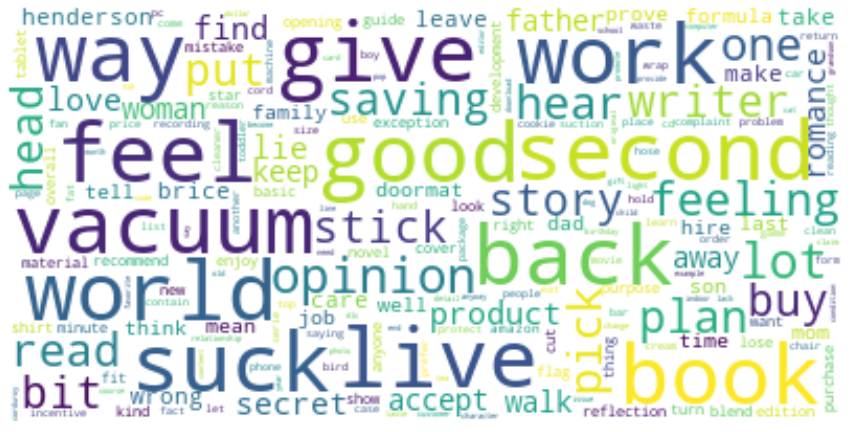

In [34]:
import matplotlib as mpl
from wordcloud import WordCloud
import matplotlib.pyplot as plt
all_words4 = Bag_Of_Words(ListWords)
ax = plt.figure(figsize=(15,10))
# Generate a word cloud image
wordcloud = WordCloud(background_color='white',max_font_size=40).generate(' '.join(all_words4.keys()))

# Display the generated image:
# the matplotlib way:
import matplotlib.pyplot as plt
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis("off")
print("Combien de Mots !!!",len(all_words4))

<AxesSubplot:>

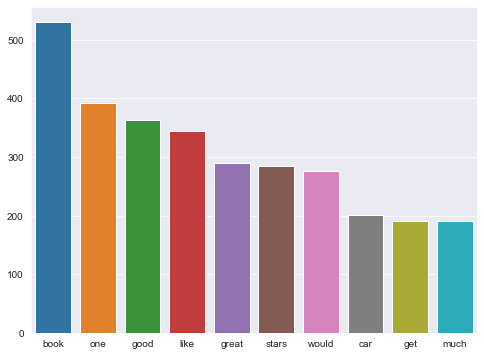

In [35]:
plt.figure(figsize = (8,6))
import seaborn as sns
from sklearn.manifold import TSNE
all_words4 = Bag_Of_Words(ListWords)
count = []
Words  = []
for w in all_words4.most_common(10):
    count.append(w[1])
    Words.append(w[0])
sns.set_style("darkgrid")
sns.barplot(Words,count)

Text(0, 0.5, 'Number of Reviews')

<Figure size 1080x576 with 0 Axes>

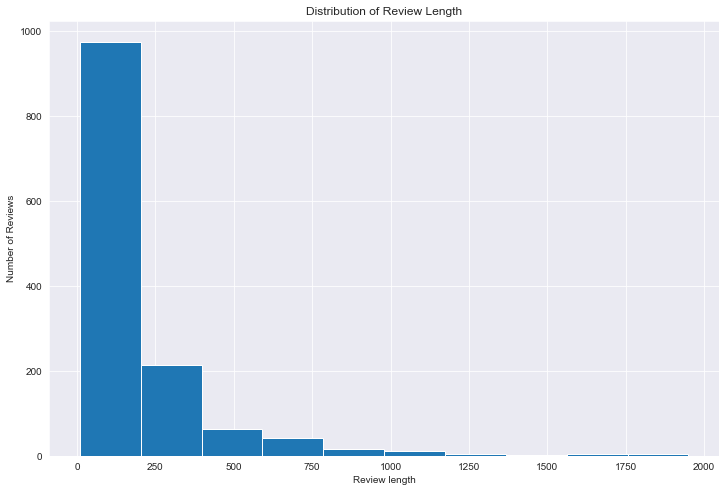

In [36]:
##########################################
## PLOT DISTRIBUTION OF REVIEW LENGTH   
##########################################
plt.figure(figsize = (15,8))

review_length = df2["review"].dropna().map(lambda x: len(x))
plt.figure(figsize=(12,8))
review_length.loc[review_length < 2000].hist()
plt.title("Distribution of Review Length")
plt.xlabel('Review length')
plt.ylabel('Number of Reviews')

In [37]:
from sklearn.feature_extraction.text import CountVectorizer
#countVec = CountVectorizer(ngram_range=(1,2), binary=True)


In [38]:
#countVec.fit(df2['review'])

In [39]:
# Transform the matriz
#transformed_matrix = countVec.transform(df2['review'])

In [40]:
# Convert matrix to array
#transformed_matrix.toarray()

In [41]:
# Extracting the feature names
#names = countVec.get_feature_names_out()

In [42]:
#names


In [43]:
df2 = df2.sample(frac=1).reset_index(drop=True)

In [44]:
y = df2['sentimentMulti'].array
y

<PandasArray>
[ 0,  1, -1,  0, -1,  0,  1,  0, -1,  1,  0,  0, -1,  1,  0,  0,  1, -1,  1,
  1,  1,  0,  1, -1,  1, -1,  1, -1,  1,  0,  1,  1, -1, -1,  1,  0,  0,  1,
  0, -1,  0, -1,  1,  1, -1,  1, -1,  1,  1,  1,  1,  0,  1, -1,  1, -1,  1,
 -1,  1,  0,  1,  1,  0,  0,  0,  1,  1, -1,  0, -1,  1, -1, -1,  0,  1,  1,
 -1, -1,  0, -1,  0,  0,  0,  0,  0,  0,  1, -1,  1,  0,  0,  0,  1,  1,  1,
  1,  1,  0,  1,  1,  1,  1, -1, -1,  0,  1,  0,  0,  0,  1, -1, -1,  0,  0,
  1, -1, -1,  0,  1,  0, -1,  0,  1,  1,  0,  1,  0,  0,  0,  1,  0, -1,  0,
 -1,  0, -1, -1, -1, -1,  0,  0,  0, -1, -1,  1, -1,  0, -1,  1,  0,  0,  1,
 -1,  1,  0,  1,  0,  1, -1,  1,  1,  1, -1,  0,  1,  0,  0,  1,  0,  1,  1,
  0, -1,  1,  1,  1,  0,  1,  0, -1,  1, -1,  1, -1,  0, -1,  1,  0,  0, -1,
  0,  0,  1, -1, -1,  1, -1,  0,  1, -1,  1,  0,  1,  1, -1, -1,  0,  1,  1,
  1,  0, -1, -1,  0,  1,  1,  0,  0,  1,  0, -1,  1,  0, -1,  1, -1,  1, -1,
  1,  1,  1, -1, -1, -1, -1,  1, -1,  0,  0,  0,  1, -1,  1,  

In [45]:
X = df2['review'].array
X

<PandasArray>
[                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                         

In [46]:
from sklearn.feature_extraction.text import TfidfVectorizer
#vectorizer = CountVectorizer(ngram_range=(1,2))
#X = vectorizer.fit_transform(X)
#vectorizer.get_feature_names_out()

In [47]:
#vectorizer.vocabulary_

In [48]:
from sklearn.model_selection import train_test_split
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import KFold
import time as t
import sklearn.metrics as sm

In [49]:
'''kfold = KFold(n_splits=10, random_state=7,shuffle=True)
clf = MultinomialNB()
scoring = 'accuracy'
cv_results = cross_val_score(clf, X, y, cv=kfold, scoring=scoring)
clf.fit(X, y)
predicted = cross_val_predict(clf, X, y, cv=10)



print("cv results ", cv_results)
print("accuracy", sm.accuracy_score(y, predicted))
print("classification report", sm.classification_report(y, predicted))
print("precision", sm.precision_score(y, predicted, average='macro'))
print("jaccard", sm.jaccard_score(y, predicted, average='macro'))
print("matthews corr", sm.matthews_corrcoef(y, predicted))
print("confusion matrix", sm.confusion_matrix(y, predicted))'''

'kfold = KFold(n_splits=10, random_state=7,shuffle=True)\nclf = MultinomialNB()\nscoring = \'accuracy\'\ncv_results = cross_val_score(clf, X, y, cv=kfold, scoring=scoring)\nclf.fit(X, y)\npredicted = cross_val_predict(clf, X, y, cv=10)\n\n\n\nprint("cv results ", cv_results)\nprint("accuracy", sm.accuracy_score(y, predicted))\nprint("classification report", sm.classification_report(y, predicted))\nprint("precision", sm.precision_score(y, predicted, average=\'macro\'))\nprint("jaccard", sm.jaccard_score(y, predicted, average=\'macro\'))\nprint("matthews corr", sm.matthews_corrcoef(y, predicted))\nprint("confusion matrix", sm.confusion_matrix(y, predicted))'

In [50]:
'''kfold = KFold(n_splits=10, random_state=7,shuffle=True)
clf = LogisticRegression(solver="liblinear", max_iter=200)
scoring = 'accuracy'
cv_results = cross_val_score(clf, X, y, cv=kfold, scoring=scoring)
clf.fit(X, y)
predicted = cross_val_predict(clf, X, y, cv=10)



print("cv results ", cv_results)
print("accuracy", sm.accuracy_score(y, predicted))
print("classification report", sm.classification_report(y, predicted))
print("precision", sm.precision_score(y, predicted, average='macro'))
print("jaccard", sm.jaccard_score(y, predicted, average='macro'))
print("matthews corr", sm.matthews_corrcoef(y, predicted))
print("confusion matrix", sm.confusion_matrix(y, predicted))'''

'kfold = KFold(n_splits=10, random_state=7,shuffle=True)\nclf = LogisticRegression(solver="liblinear", max_iter=200)\nscoring = \'accuracy\'\ncv_results = cross_val_score(clf, X, y, cv=kfold, scoring=scoring)\nclf.fit(X, y)\npredicted = cross_val_predict(clf, X, y, cv=10)\n\n\n\nprint("cv results ", cv_results)\nprint("accuracy", sm.accuracy_score(y, predicted))\nprint("classification report", sm.classification_report(y, predicted))\nprint("precision", sm.precision_score(y, predicted, average=\'macro\'))\nprint("jaccard", sm.jaccard_score(y, predicted, average=\'macro\'))\nprint("matthews corr", sm.matthews_corrcoef(y, predicted))\nprint("confusion matrix", sm.confusion_matrix(y, predicted))'

In [51]:
''''#kfold = KFold(n_splits=10, random_state=7,shuffle=True)
clf = RandomForestClassifier()
# Splitting Dataset into train and test set 
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.25, random_state=42)
#scoring = 'accuracy'
#cv_results = cross_val_score(clf, X_TFidf, y, cv=kfold, scoring=scoring)
clf.fit(X_train, y_train)
predicted = clf.predict(X_test)



#print("cv results ", cv_results)
print("accuracy", sm.accuracy_score(y_test, predicted))
print("classification report", sm.classification_report(y_test, predicted))
print("precision", sm.precision_score(y_test, predicted, average='macro'))
print("jaccard", sm.jaccard_score(y_test, predicted, average='macro'))
print("matthews corr", sm.matthews_corrcoef(y_test, predicted))
print("confusion matrix", sm.confusion_matrix(y_test, predicted))'''

'\'#kfold = KFold(n_splits=10, random_state=7,shuffle=True)\nclf = RandomForestClassifier()\n# Splitting Dataset into train and test set \nX_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.25, random_state=42)\n#scoring = \'accuracy\'\n#cv_results = cross_val_score(clf, X_TFidf, y, cv=kfold, scoring=scoring)\nclf.fit(X_train, y_train)\npredicted = clf.predict(X_test)\n\n\n\n#print("cv results ", cv_results)\nprint("accuracy", sm.accuracy_score(y_test, predicted))\nprint("classification report", sm.classification_report(y_test, predicted))\nprint("precision", sm.precision_score(y_test, predicted, average=\'macro\'))\nprint("jaccard", sm.jaccard_score(y_test, predicted, average=\'macro\'))\nprint("matthews corr", sm.matthews_corrcoef(y_test, predicted))\nprint("confusion matrix", sm.confusion_matrix(y_test, predicted))'

In [52]:
'''from sklearn.svm import LinearSVC
kfold = KFold(n_splits=10, random_state=7,shuffle=True)
clf = LinearSVC()
scoring = 'accuracy'
cv_results = cross_val_score(clf, X, y, cv=kfold, scoring=scoring)
clf.fit(X, y)
predicted = cross_val_predict(clf, X, y, cv=10)



print("cv results ", cv_results)
print("accuracy", sm.accuracy_score(y, predicted))
print("classification report", sm.classification_report(y, predicted))
print("precision", sm.precision_score(y, predicted, average='macro'))
print("jaccard", sm.jaccard_score(y, predicted, average='macro'))
print("matthews corr", sm.matthews_corrcoef(y, predicted))
print("confusion matrix", sm.confusion_matrix(y, predicted))'''

'from sklearn.svm import LinearSVC\nkfold = KFold(n_splits=10, random_state=7,shuffle=True)\nclf = LinearSVC()\nscoring = \'accuracy\'\ncv_results = cross_val_score(clf, X, y, cv=kfold, scoring=scoring)\nclf.fit(X, y)\npredicted = cross_val_predict(clf, X, y, cv=10)\n\n\n\nprint("cv results ", cv_results)\nprint("accuracy", sm.accuracy_score(y, predicted))\nprint("classification report", sm.classification_report(y, predicted))\nprint("precision", sm.precision_score(y, predicted, average=\'macro\'))\nprint("jaccard", sm.jaccard_score(y, predicted, average=\'macro\'))\nprint("matthews corr", sm.matthews_corrcoef(y, predicted))\nprint("confusion matrix", sm.confusion_matrix(y, predicted))'

In [53]:
from sklearn.feature_extraction.text import TfidfVectorizer
#y = df2['sentimentBinary'].array
X_TFidf = df2['review'].array
vectorizer = TfidfVectorizer(ngram_range=(1,2))
X_TFidf = vectorizer.fit_transform(X_TFidf)
vectorizer.get_feature_names_out()

array(['aaaaaany', 'aaaaaany day', 'abandon', ..., 'zone say',
       'ztorylinewell', 'ztorylinewell laid'], dtype=object)

In [54]:
kfold = KFold(n_splits=10, random_state=7,shuffle=True)
clf = MultinomialNB()
scoring = 'accuracy'
cv_results = cross_val_score(clf, X_TFidf, y, cv=kfold, scoring=scoring)
clf.fit(X_TFidf, y)
predicted = cross_val_predict(clf, X_TFidf, y, cv=3)



print("cv results ", cv_results)
print("accuracy", sm.accuracy_score(y, predicted))
print("classification report", sm.classification_report(y, predicted))
print("precision", sm.precision_score(y, predicted, average='macro'))
print("jaccard", sm.jaccard_score(y, predicted, average='macro'))
print("matthews corr", sm.matthews_corrcoef(y, predicted))
print("confusion matrix", sm.confusion_matrix(y, predicted))

cv results  [0.7037037  0.80597015 0.74626866 0.7761194  0.79850746 0.79104478
 0.82089552 0.86567164 0.74626866 0.84328358]
accuracy 0.7897091722595079
classification report               precision    recall  f1-score   support

          -1       0.74      0.73      0.73       448
           0       0.76      0.68      0.72       448
           1       0.85      0.96      0.90       445

    accuracy                           0.79      1341
   macro avg       0.79      0.79      0.79      1341
weighted avg       0.79      0.79      0.79      1341

precision 0.7858302550355066
jaccard 0.6558399853197541
matthews corr 0.6861785216973806
confusion matrix [[325  86  37]
 [105 306  37]
 [  7  10 428]]


In [55]:
'''kfold = KFold(n_splits=10, random_state=7,shuffle=True)
clf = LogisticRegression(solver="liblinear", max_iter=200)
scoring = 'accuracy'
cv_results = cross_val_score(clf, X_TFidf, y, cv=kfold, scoring=scoring)
clf.fit(X_TFidf, y)
predicted = cross_val_predict(clf, X_TFidf, y, cv=10)



print("cv results ", cv_results)
print("accuracy", sm.accuracy_score(y, predicted))
print("classification report", sm.classification_report(y, predicted))
print("precision", sm.precision_score(y, predicted, average='macro'))
print("jaccard", sm.jaccard_score(y, predicted, average='macro'))
print("matthews corr", sm.matthews_corrcoef(y, predicted))
print("confusion matrix", sm.confusion_matrix(y, predicted))'''

'kfold = KFold(n_splits=10, random_state=7,shuffle=True)\nclf = LogisticRegression(solver="liblinear", max_iter=200)\nscoring = \'accuracy\'\ncv_results = cross_val_score(clf, X_TFidf, y, cv=kfold, scoring=scoring)\nclf.fit(X_TFidf, y)\npredicted = cross_val_predict(clf, X_TFidf, y, cv=10)\n\n\n\nprint("cv results ", cv_results)\nprint("accuracy", sm.accuracy_score(y, predicted))\nprint("classification report", sm.classification_report(y, predicted))\nprint("precision", sm.precision_score(y, predicted, average=\'macro\'))\nprint("jaccard", sm.jaccard_score(y, predicted, average=\'macro\'))\nprint("matthews corr", sm.matthews_corrcoef(y, predicted))\nprint("confusion matrix", sm.confusion_matrix(y, predicted))'

In [56]:
'''kfold = KFold(n_splits=10, random_state=7,shuffle=True)
clf = LinearSVC()
scoring = 'accuracy'
cv_results = cross_val_score(clf, X_TFidf, y, cv=kfold, scoring=scoring)
clf.fit(X_TFidf, y)
predicted = cross_val_predict(clf, X_TFidf, y, cv=10)



print("cv results ", cv_results)
print("accuracy", sm.accuracy_score(y, predicted))
print("classification report", sm.classification_report(y, predicted))
print("precision", sm.precision_score(y, predicted, average='macro'))
print("jaccard", sm.jaccard_score(y, predicted, average='macro'))
print("matthews corr", sm.matthews_corrcoef(y, predicted))
print("confusion matrix", sm.confusion_matrix(y, predicted))'''

'kfold = KFold(n_splits=10, random_state=7,shuffle=True)\nclf = LinearSVC()\nscoring = \'accuracy\'\ncv_results = cross_val_score(clf, X_TFidf, y, cv=kfold, scoring=scoring)\nclf.fit(X_TFidf, y)\npredicted = cross_val_predict(clf, X_TFidf, y, cv=10)\n\n\n\nprint("cv results ", cv_results)\nprint("accuracy", sm.accuracy_score(y, predicted))\nprint("classification report", sm.classification_report(y, predicted))\nprint("precision", sm.precision_score(y, predicted, average=\'macro\'))\nprint("jaccard", sm.jaccard_score(y, predicted, average=\'macro\'))\nprint("matthews corr", sm.matthews_corrcoef(y, predicted))\nprint("confusion matrix", sm.confusion_matrix(y, predicted))'

In [57]:
df_tweets = pd.read_csv('tweetsfirst.csv')

In [58]:
df_tweets['content'].dropna()
df2_tweets = df_tweets.drop_duplicates(subset=['content'])

In [59]:
df2_tweets['content'] = df2_tweets['content'].apply(lambda x: cleaning_numbers(x))
df2_tweets['content'].tail()

18196    Big welcome back to the UK for Luo Dexiu,  over from Taiwan for a Baguazhang seminar.   Sorry I can't be there to benefit from his wisdom.
18197    Is it just me that missed it or have we not had DR DANCE on yet? @bbbots_uk @bbuk #bbbots                                                 
18198    @LynneMcGranger watching @homeandaway in the #UK and I feel saddened that everyone has forgot Irene.....\n#peopleireneismissing           
18199    @JaneAitchison @StarSparkle_UK GOOD LUCK JANE.                                                                                            
18200    Lord have mercy on the UK if she becomes the next leader. https://t.co/sfYYKAPA                                                           
Name: content, dtype: object

In [60]:
df2_tweets['content'] = df2_tweets['content'].apply(lambda x: cleaning_numbers(x))
df2_tweets['content'].tail()
# expand contractions
index_replace = df2_tweets[df2_tweets.content.str.contains('|'.join(contractions_dict.keys()), regex=True)].index
df_new = df2_tweets['content']
df_new.loc[index_replace].apply(lambda x: contractions.fix(x))
df2_tweets['content'] = df_new
df2_tweets['content'] = df2_tweets['content'].apply(lambda x: cleaning_repeating_char(x))
df2_tweets['content'] = df2_tweets['content'].apply(lambda x: cleaning_punctuations(x))
df2_tweets['content'] = df2_tweets['content'].apply(lambda text: cleaning_stopwords(text))

In [61]:
df2_tweets['content'].head()

0    maninyohouse ha ha yea Im uk always play US                                                    
1    Classical “ Quality Build ” absolutely second none FREE UK DELIVERY STOCK WBX httpstcoorGLpBBih
2    GrouponUK submit cancel form trying get hold customer services website use                     
3    ErinReags Happened UK Channel httpstcodtCMScsYL                                                
4    Happy happy Year new… httpstcorSSLheFHU                                                        
Name: content, dtype: object

In [62]:
from sklearn.feature_extraction.text import TfidfVectorizer
#y = df2['sentimentBinary'].array
X_TFidf_tweets = df2_tweets['content'].array
X_TFidf_tweets = vectorizer.transform(X_TFidf_tweets)


In [63]:
X_TFidf

<1341x39863 sparse matrix of type '<class 'numpy.float64'>'
	with 69099 stored elements in Compressed Sparse Row format>

In [64]:
X_TFidf_tweets

<18109x39863 sparse matrix of type '<class 'numpy.float64'>'
	with 97041 stored elements in Compressed Sparse Row format>

In [65]:
pred_test = clf.predict(X_TFidf_tweets)

In [66]:
len(pred_test)

18109

In [67]:
len(pred_test)

18109